In [ ]:
!pip install split-folders

In [ ]:
#===============================================================================
import random
import numpy as np
import matplotlib.pyplot as plt
import os
#===============================================================================
import tensorflow as tf
#===============================================================================
import keras as keras
from keras import models
from keras.applications.inception_v3 import InceptionV3
from keras.layers import Flatten, Dense, Dropout, GlobalAveragePooling2D, Concatenate, AveragePooling2D
from keras.preprocessing.image import ImageDataGenerator, NumpyArrayIterator
from keras.utils import to_categorical
#===============================================================================
import cv2
#===============================================================================
import splitfolders
#===============================================================================
from google.colab import drive
#===============================================================================

# Loading and preparing dataset

In [ ]:
# Global params init
drive.mount('/content/drive')
lab_5_data = "/content/drive/MyDrive/Colab Notebooks/STDINNS_lab_5_dataset"
dataset_dir = lab_5_data + "/Dataset"
splitted_dtst_dir = lab_5_data + "/Splitted_dataset"
splitted_2 = "STDINNS splitted dataset lab 5"

Mounted at /content/drive


In [ ]:
# Loading classes information
class_Names = list(os.walk(dataset_dir))[0][1]
class_Names.sort()

'''
# Creating array with classes actual names
actual_names = ['Abyssinian',         # Class #0
                'Bengal',             # Class #1
                'Birman',             # Class #2
                'Bombay',             # Class #3
                'British Shorthair',  # Class #4
                'Egyptian Mau',       # Class #5
                'Maine Coon',         # Class #6
                'Persian',            # Class #7
                'Ragdoll',            # Class #8
                'Russian Blue',       # Class #9
                'Siamese',            # Class #10
                'Sphynx']             # Class #11
'''

class_number = len(class_Names)

# Displaying these classes
print(f"Dataset has {class_number} classes in total:")
for class_id, class_label in enumerate(class_Names):
    print(f'Class #{class_id} ==> {class_label}')

Dataset has 12 classes in total:
Class #0 ==> Abyssinian
Class #1 ==> Bengal
Class #2 ==> Birman
Class #3 ==> Bombay
Class #4 ==> British Shorthair
Class #5 ==> Egyptian Mau
Class #6 ==> Maine Coon
Class #7 ==> Persian
Class #8 ==> Ragdoll
Class #9 ==> Russian Blue
Class #10 ==> Siamese
Class #11 ==> Sphynx


In [ ]:
# Dataset init and splitting into 3 sets:
# - Train ===========> 70% of the dataset
# - Validation ======> 20% of the dataset
# - Test ============> 10% of the dataset
def split_data(data_path, result_path):
        data = data_path
        output = result_path
        splitfolders.ratio(data, output, seed = 42, ratio = (0.7, 0.275, 0.025), group_prefix = None)

split_data(dataset_dir, splitted_2)

Copying files: 2391 files [01:00, 39.62 files/s]


In [ ]:
'''
def split_data_2(data_path, result_path):
    data = data_path
    output = result_path
    splitfolders.ratio(data, output, seed = 42, ratio = (0.7, 0.275, 0.025), group_prefix = None)

split_data(dataset_dir, splitted_dtst_dir)
'''

Copying files: 2391 files [01:56, 20.54 files/s] 


In [ ]:
# Splitted datasets directories
'''
train_ds_dir = splitted_dtst_dir + "/train"
validation_ds_dir = splitted_dtst_dir + "/val"
test_ds_dir = splitted_dtst_dir + "/test"
'''

train_ds_dir = splitted_2 + "/train"
validation_ds_dir = splitted_2 + "/val"
test_ds_dir = splitted_2 + "/test"

# Making datasets from splitted folders
def load_data(dataset_dir):
    dataset = keras.preprocessing.image_dataset_from_directory(
        dataset_dir,
        labels = 'inferred',
        label_mode = 'int',
        class_names = class_Names,
        color_mode = 'rgb',
        batch_size = None,
        image_size = (224, 224),
        shuffle = False,
        seed = 25625,
        validation_split = None,
        interpolation = 'nearest'
    )

    return dataset

In [ ]:
# Getting train dataset data
train_dataset = load_data(train_ds_dir)

# Getting validation dataset data
validation_dataset = load_data(validation_ds_dir)

# Getting test dataset data
test_dataset = load_data(test_ds_dir)

# Viewing info about size
print("Train:", len(train_dataset))
print("Validation:", len(validation_dataset))
print("Test:", len(test_dataset))

Found 1671 files belonging to 12 classes.
Found 655 files belonging to 12 classes.
Found 62 files belonging to 12 classes.
Train: 1671
Validation: 655
Test: 62


In [ ]:
# Shuffling datasets
train_dataset = train_dataset.shuffle(buffer_size = 1700, seed = 42, reshuffle_each_iteration=False)
validation_dataset = validation_dataset.shuffle(buffer_size = 700, seed = 42, reshuffle_each_iteration=False)
test_dataset =  test_dataset.shuffle(buffer_size = 70, seed = 42, reshuffle_each_iteration=False)

In [ ]:
# Creating func that shows images from splitted dataset
def show_images(dtst, size, act_name = class_Names):
    plt.figure(figsize = (15, 15))
    for i, (image, label) in enumerate(dtst.take(size)):
        plt.subplot(5, 5, i + 1)
        plt.xticks([])
        plt.yticks([])
        plt.grid(False)
        plt.imshow(image)
        plt.xlabel(f"Class: #{label.numpy()} ({act_name[label.numpy()]})")
    plt.show()

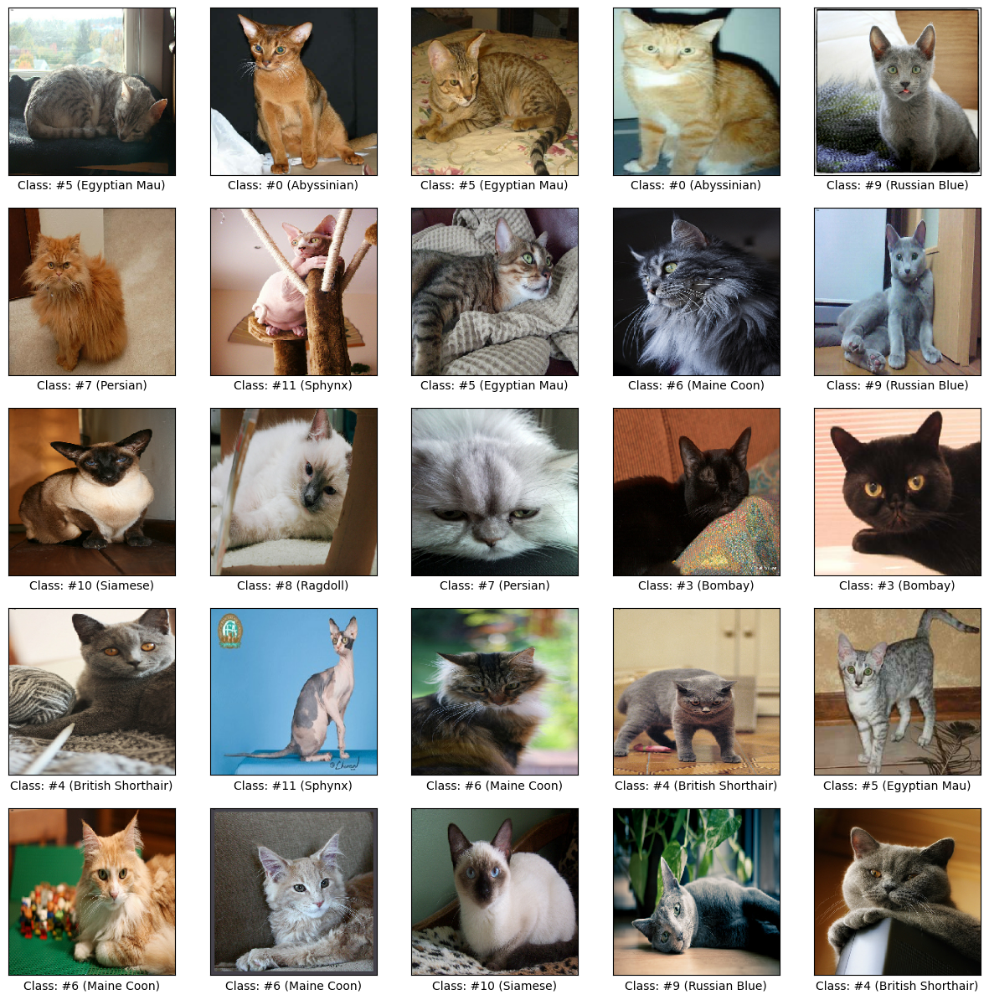

In [ ]:
# Viewing random images from train dataset
show_images(train_dataset, 25)

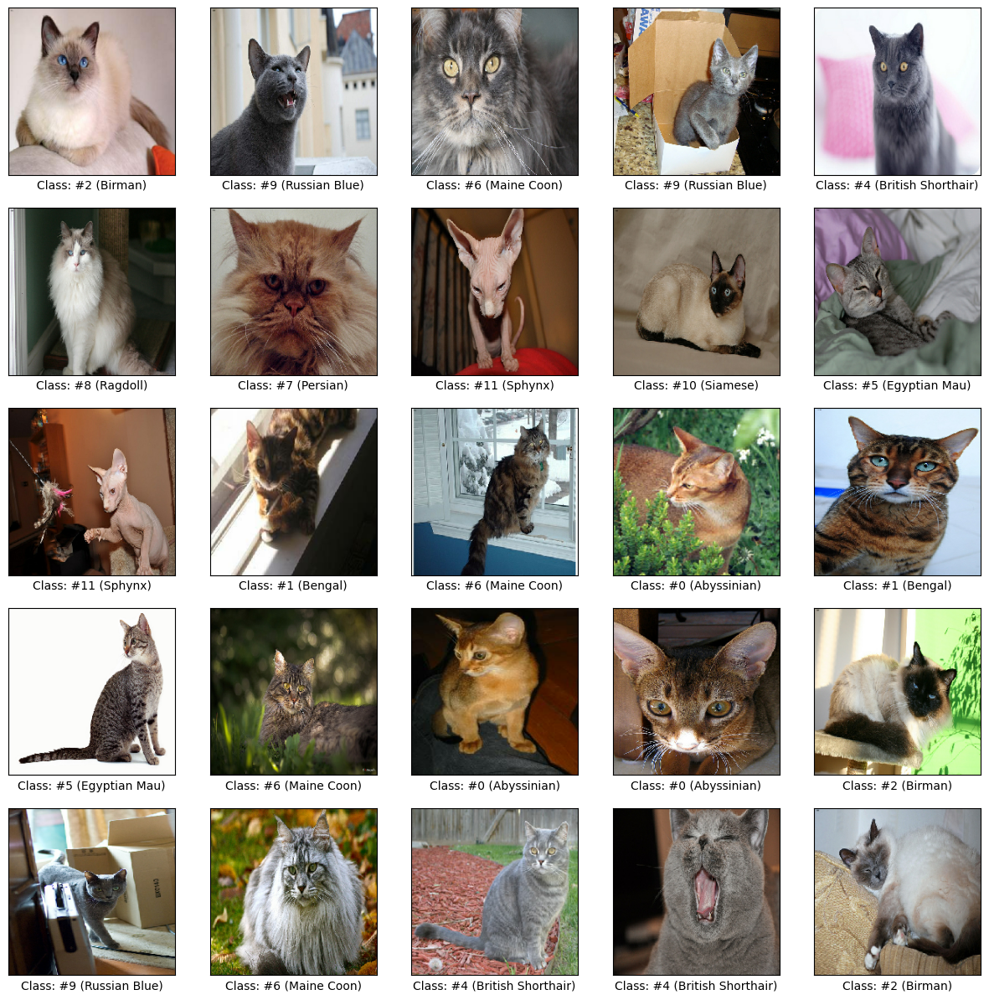

In [ ]:
# Viewing images from validation dataset
show_images(validation_dataset, 25)

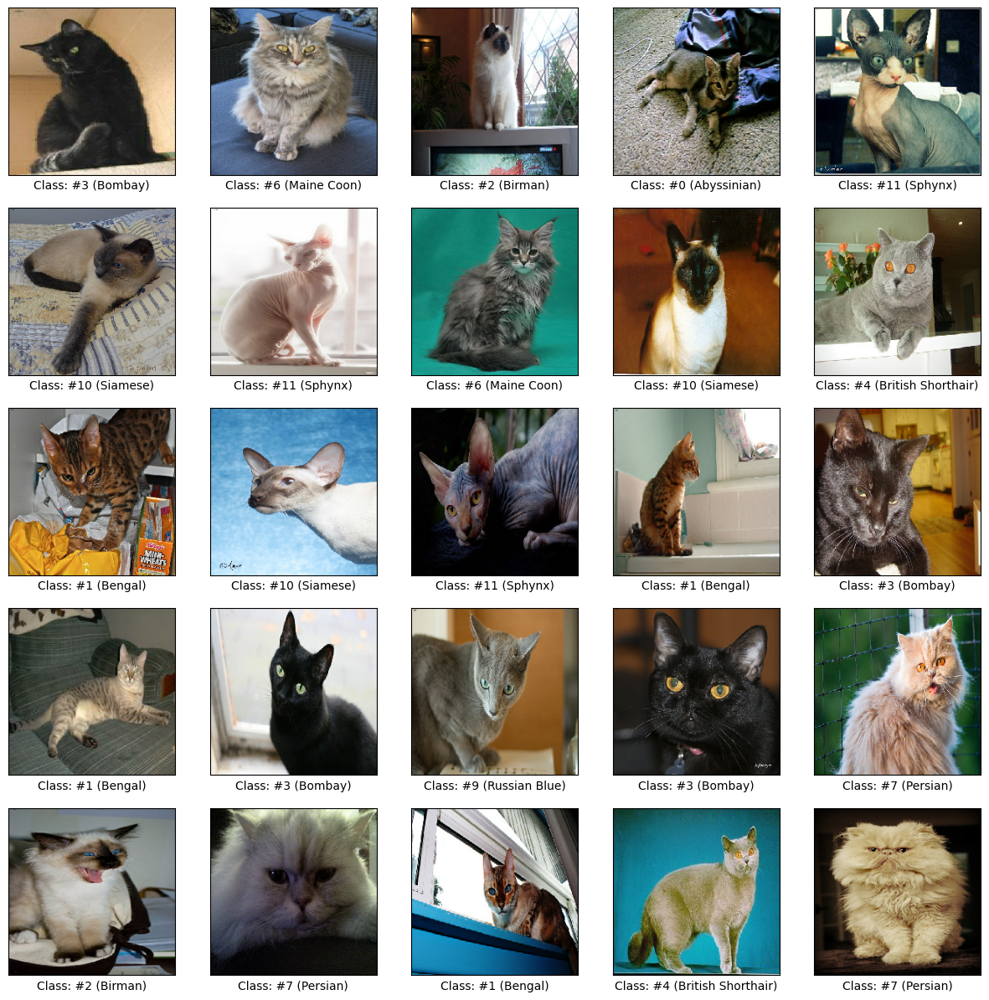

In [ ]:
# Viewing images from test dataset
show_images(test_dataset, 25)

In [ ]:
# Preparing datasets (data shuffling, augmentation)
x_train, y_train = list(map(lambda img: img[0], train_dataset)), list(map(lambda img: img[1], train_dataset))
x_valid, y_valid = list(map(lambda img: img[0], validation_dataset)), list(map(lambda img: img[1], validation_dataset))
x_test, y_test = list(map(lambda img: img[0], test_dataset)), list(map(lambda img: img[1], test_dataset))

y_train = to_categorical(y_train, class_number)
y_valid = to_categorical(y_valid, class_number)
y_test = to_categorical(y_test, class_number)

del train_dataset
del validation_dataset
del test_dataset

In [ ]:
# Image augmentation

# Train dataset augmentation
train_datagen = ImageDataGenerator(rescale=1./255,           # rescaling RGB coefs from 0-225 to 0-1
                                   rotation_range = 30,      # random rotations in range (-30° - +30°)
                                   width_shift_range = 0.1,  # random horizontal shifts by 10% of image size
                                   height_shift_range = 0.1, # random vertical shifts by 10% of image size
                                   shear_range = 0.2,        # random image shearing transformation by 20%
                                   zoom_range = 0.2,         # random zoom in range (80% - 120%)
                                   horizontal_flip = True,   # random horizontal image reflection
                                   fill_mode = "nearest")    # rule for how to fill pixels that are outside the image boundaries

# Validation dataset augmentation
validation_datagen = ImageDataGenerator(rescale=1./255) # rescaling RGB coefs from 0-225 to 0-1

# Validation dataset augmentation
test_datagen = ImageDataGenerator(rescale=1./255) # rescaling RGB coefs from 0-225 to 0-1

In [ ]:
train_dataset = NumpyArrayIterator(x = np.array(x_train),
                                   y = np.array(y_train),
                                   image_data_generator = train_datagen,
                                   batch_size = 3)

validation_dataset = NumpyArrayIterator(x = np.array(x_valid),
                                        y = np.array(y_valid),
                                        image_data_generator = validation_datagen,
                                        batch_size = 5)

test_dataset = NumpyArrayIterator(x = np.array(x_test),
                                  y = np.array(y_test),
                                  image_data_generator = test_datagen,
                                  batch_size = 1)

# Viewing info about size
print("Train:", len(train_dataset))
print("Validation:", len(validation_dataset))
print("Test:", len(test_dataset))

Train: 557
Validation: 131
Test: 62


In [ ]:
# View preprocessed dataset images examples
def show_preprocessed_images(dtst, size, act_name = class_Names):
    plt.figure(figsize = (15, 15))
    for i in range(size):
        image, label = dtst[i]
        label_index = np.argmax(label)
        plt.subplot(5, 5, i+1)
        plt.xticks([])
        plt.yticks([])
        plt.grid(False)
        plt.imshow(image[0])
        plt.xlabel(f"Class: #{label_index} ({act_name[label_index]})")
    plt.show()

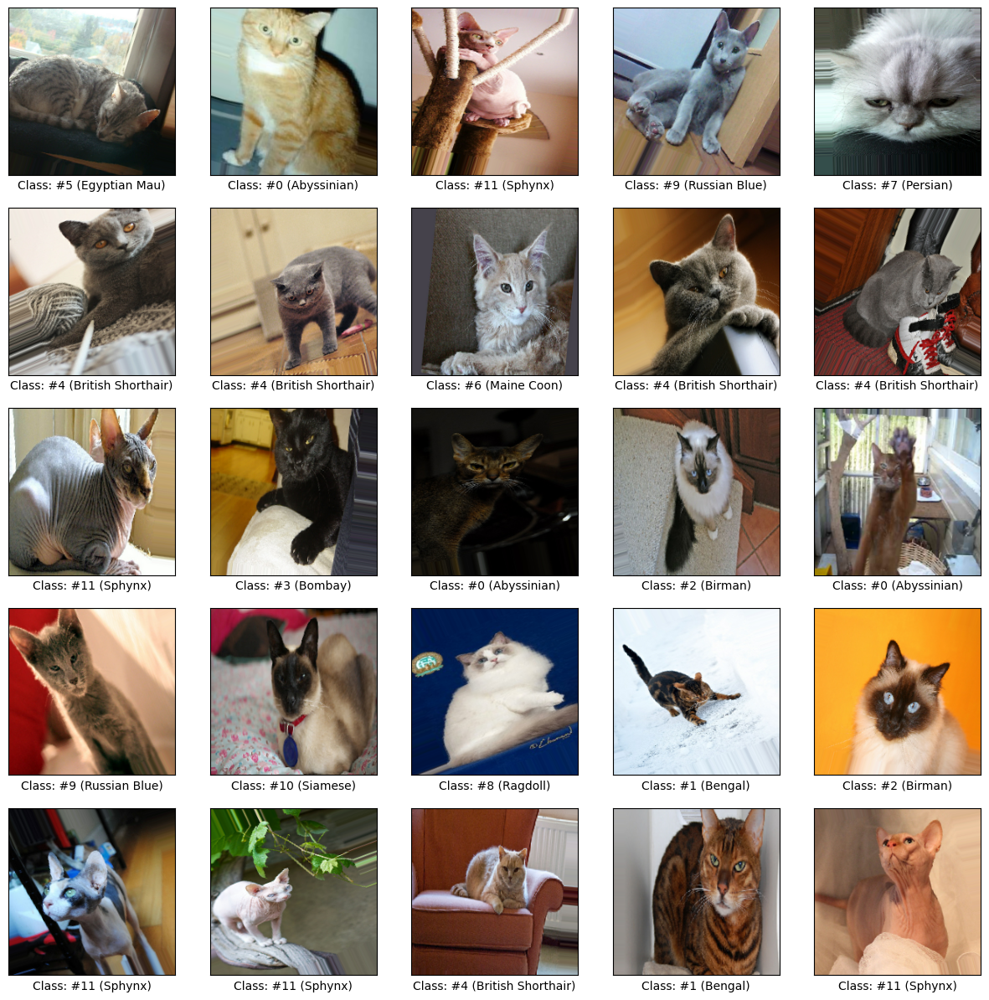

In [ ]:
show_preprocessed_images(train_dataset, 25)

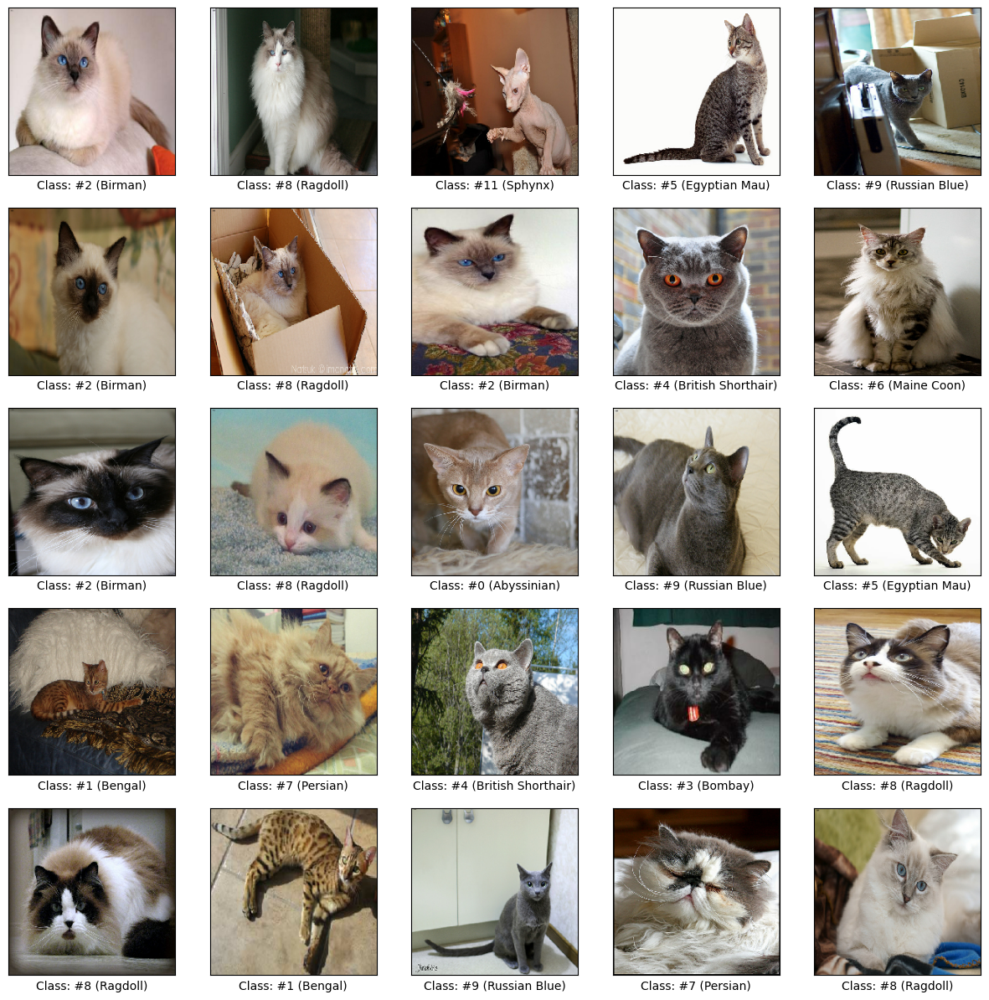

In [ ]:
show_preprocessed_images(validation_dataset, 25)

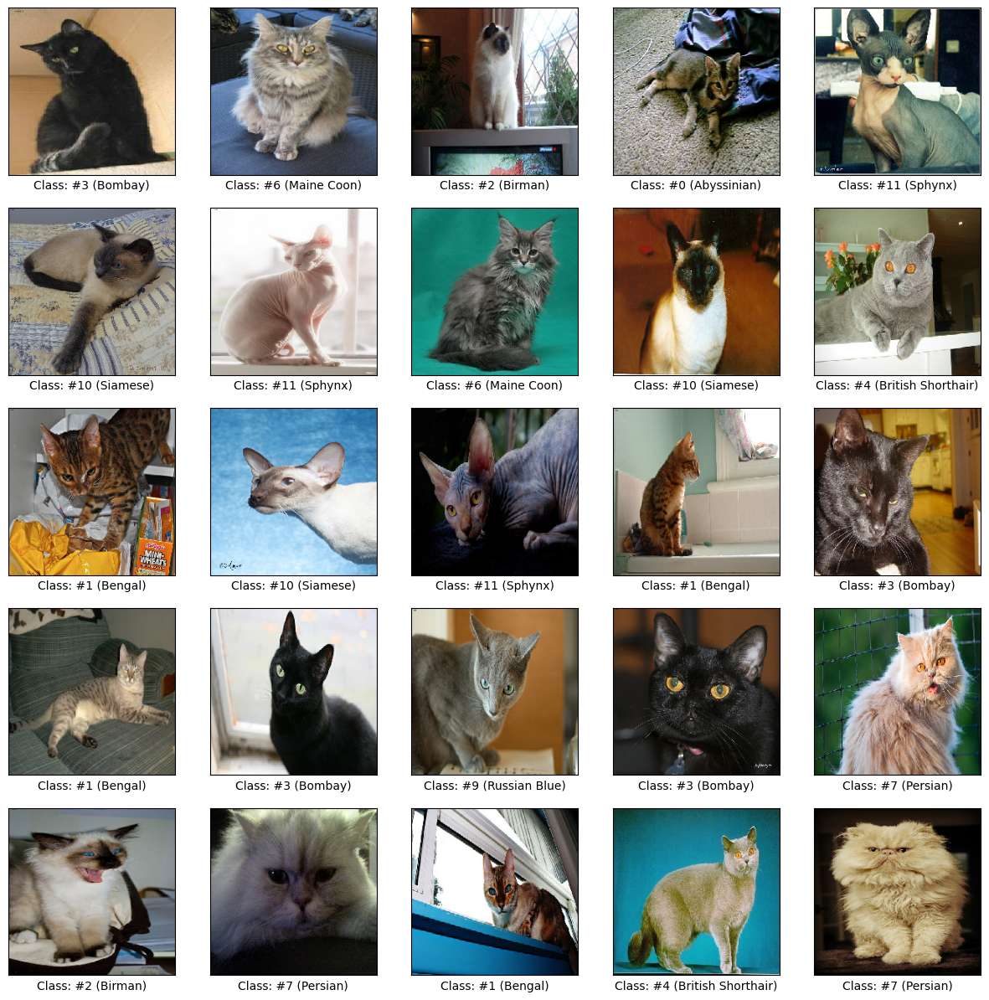

In [ ]:
show_preprocessed_images(test_dataset, 25)

In [ ]:
# Create InceptionV3 model
inceptionV3_model = InceptionV3(weights = 'imagenet', include_top = False, input_shape = (224, 224, 3))

for layer in inceptionV3_model.layers:
    layer.trainable = False

x = GlobalAveragePooling2D()(inceptionV3_model.output)
x = Dense(1024, activation = 'relu')(x)
x = Dropout(0.5)(x)
output = Dense(class_number, activation = 'softmax')(x)

inceptionV3_model = keras.models.Model(inputs = inceptionV3_model.input, outputs = output)

# Compile InceptionV3 model
inceptionV3_model.compile(optimizer = 'adam',
                          loss = 'categorical_crossentropy',
                          metrics = ['accuracy'])

87910968/87910968 [==============================] - 1s 0us/step


In [ ]:
inceptionV3_model.summary()

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, 224, 224, 3)]        0         []                            
                                                                                                  
 conv2d (Conv2D)             (None, 111, 111, 32)         864       ['input_1[0][0]']             
                                                                                                  
 batch_normalization (Batch  (None, 111, 111, 32)         96        ['conv2d[0][0]']              
 Normalization)                                                                                   
                                                                                                  
 activation (Activation)     (None, 111, 111, 32)         0         ['batch_normalization[0][0

In [ ]:
# Train InceptionV3 model
history = inceptionV3_model.fit(train_dataset,
                                epochs = 100,
                                validation_data = validation_dataset,
                                validation_freq = 1)

Epoch 1/100
557/557 [==============================] - 44s 60ms/step - loss: 1.6880 - accuracy: 0.5643 - val_loss: 0.5887 - val_accuracy: 0.7802
Epoch 2/100
557/557 [==============================] - 30s 54ms/step - loss: 0.9708 - accuracy: 0.6571 - val_loss: 0.5707 - val_accuracy: 0.7664
Epoch 3/100
557/557 [==============================] - 31s 55ms/step - loss: 0.8401 - accuracy: 0.6960 - val_loss: 0.4565 - val_accuracy: 0.8137
Epoch 4/100
557/557 [==============================] - 31s 55ms/step - loss: 0.7942 - accuracy: 0.7092 - val_loss: 0.4292 - val_accuracy: 0.8443
Epoch 5/100
557/557 [==============================] - 31s 56ms/step - loss: 0.7674 - accuracy: 0.7271 - val_loss: 0.4921 - val_accuracy: 0.8168
Epoch 6/100
557/557 [==============================] - 31s 56ms/step - loss: 0.7290 - accuracy: 0.7427 - val_loss: 0.4211 - val_accuracy: 0.8366
Epoch 7/100
557/557 [==============================] - 31s 55ms/step - loss: 0.7803 - accuracy: 0.7187 - val_loss: 0.4785 - val_ac

In [ ]:
# Saving model
inceptionV3_model.save("Custom_InceptionV3_model.keras")
inceptionV3_model.save(lab_5_data + "/Custom_InceptionV3_model.keras")

# View train|validation stats graphs


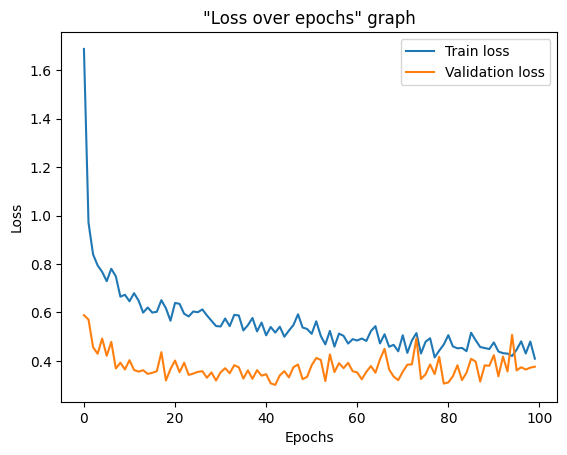

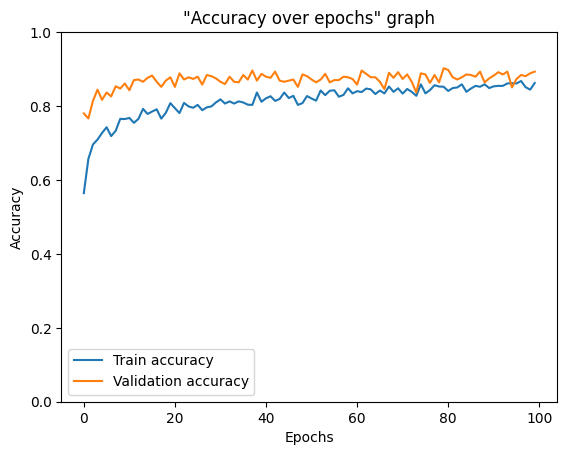

In [ ]:
# View train|validation stats graphs

# Plotting "Loss over epochs" graph
plt.plot(history.history['loss'], label = 'Train loss')
plt.plot(history.history['val_loss'], label = 'Validation loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.title('"Loss over epochs" graph')
plt.legend()
plt.show()

# Plotting "Accuracy over epoch" graph
plt.plot(history.history['accuracy'], label = 'Train accuracy')
plt.plot(history.history['val_accuracy'], label = 'Validation accuracy')
plt.xlabel('Epochs')
plt.ylabel('Accuracy')
plt.title('"Accuracy over epochs" graph')
plt.ylim([0, 1])
plt.legend()
plt.show()

#View predictions on images from test dataset

In [ ]:
# View predictions on images from test dataset
def predictions_plot(dtst, size, act_name = class_Names):
    plt.figure(figsize = (17, 32))
    for i in range(size):
        image, label = dtst[i]

        real_label_index = np.argmax(label)
        real_label = act_name[real_label_index]

        image_for_prediction = image[0]
        image_for_prediction = tf.expand_dims(image_for_prediction, axis = 0)

        prediction = inceptionV3_model.predict(image_for_prediction)
        predicted_label = np.argmax(prediction)

        plt.subplot(11, 6, i+1)
        plt.xticks([])
        plt.yticks([])
        plt.grid(False)
        plt.imshow(image[0])

        plt.xlabel(f"Real: #{real_label_index} ({real_label})\n" +
                   f"Predicted: #{predicted_label} ({act_name[predicted_label]})",
                   color = 'green' if predicted_label == real_label_index else 'red')
    plt.show()

1/1 [==============================] - 0s 26ms/step


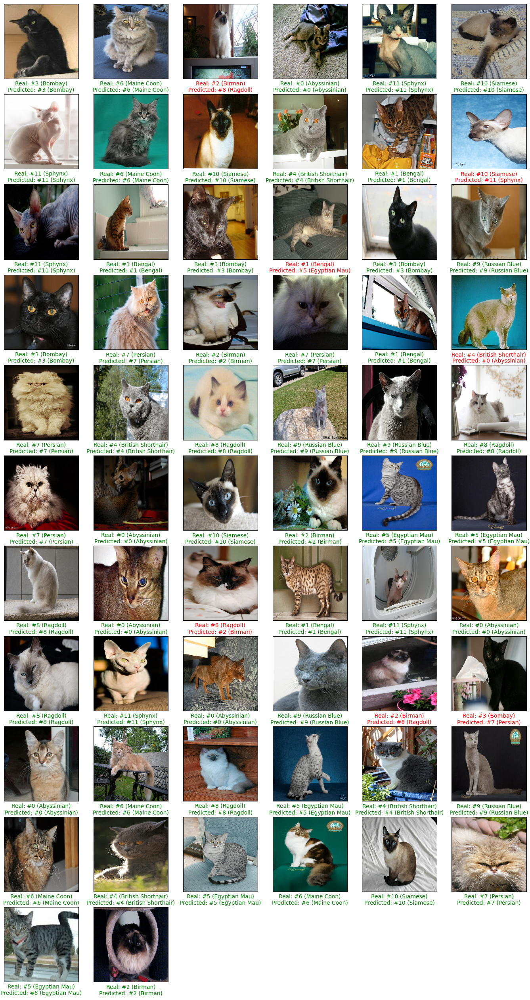

In [ ]:
predictions_plot(test_dataset, 62)